# Hoti

In [3]:
from pylab import *
from pylab import *
import matplotlib.pyplot as plt
from matplotlib.collections import PatchCollection
from matplotlib.patches import Rectangle
mpl.rcParams.update({'font.size':18})

In [4]:
import os

if not os.path.exists("images"):
    os.mkdir("images")

if not os.path.exists("images/video_images"):
    os.mkdir("images/video_images")
    
if not os.path.exists("images/video_images2"):
    os.mkdir("images/video_images2")

if not os.path.exists("images/video_images3"):
    os.mkdir("images/video_images3")

In [5]:
name_array = "LatticeSierpinski_18x18.xyz"
epsi = 0.0
nval = 1.0
cal_value = True

# Modelo finito 

In [6]:
x,y,f = np.loadtxt(name_array,usecols=(1,2,4),skiprows=2,unpack=True)
ind = np.argsort(f)
#x,y,f = x[ind], y[ind], f[ind]

In [7]:
x

array([ 0.,  1.,  0.,  1.,  0.,  1.,  0.,  1.,  0.,  1.,  0.,  1.,  2.,
        3.,  2.,  3.,  2.,  3.,  2.,  3.,  4.,  5.,  4.,  5.,  4.,  5.,
        4.,  5.,  4.,  5.,  4.,  5.,  0.,  1.,  0.,  1.,  0.,  1.,  0.,
        1.,  0.,  1.,  0.,  1.,  2.,  3.,  2.,  3.,  2.,  3.,  2.,  3.,
        4.,  5.,  4.,  5.,  4.,  5.,  4.,  5.,  4.,  5.,  4.,  5.,  0.,
        1.,  0.,  1.,  0.,  1.,  0.,  1.,  0.,  1.,  0.,  1.,  2.,  3.,
        2.,  3.,  2.,  3.,  2.,  3.,  4.,  5.,  4.,  5.,  4.,  5.,  4.,
        5.,  4.,  5.,  4.,  5.,  6.,  7.,  6.,  7.,  6.,  7.,  6.,  7.,
        6.,  7.,  6.,  7.,  8.,  9.,  8.,  9.,  8.,  9.,  8.,  9., 10.,
       11., 10., 11., 10., 11., 10., 11., 10., 11., 10., 11.,  6.,  7.,
        6.,  7.,  6.,  7.,  6.,  7.,  6.,  7.,  6.,  7.,  8.,  9.,  8.,
        9.,  8.,  9.,  8.,  9., 10., 11., 10., 11., 10., 11., 10., 11.,
       10., 11., 10., 11., 12., 13., 12., 13., 12., 13., 12., 13., 12.,
       13., 12., 13., 14., 15., 14., 15., 14., 15., 14., 15., 16

In [8]:
f

array([ 0.,  0.,  0.,  0.,  1.,  1.,  1.,  1.,  2.,  2.,  2.,  2.,  3.,
        3.,  3.,  3.,  4.,  4.,  4.,  4.,  5.,  5.,  5.,  5.,  6.,  6.,
        6.,  6.,  7.,  7.,  7.,  7.,  8.,  8.,  8.,  8.,  9.,  9.,  9.,
        9., 10., 10., 10., 10., 11., 11., 11., 11., 12., 12., 12., 12.,
       13., 13., 13., 13., 14., 14., 14., 14., 15., 15., 15., 15., 16.,
       16., 16., 16., 17., 17., 17., 17., 18., 18., 18., 18., 19., 19.,
       19., 19., 20., 20., 20., 20., 21., 21., 21., 21., 22., 22., 22.,
       22., 23., 23., 23., 23., 24., 24., 24., 24., 25., 25., 25., 25.,
       26., 26., 26., 26., 27., 27., 27., 27., 28., 28., 28., 28., 29.,
       29., 29., 29., 30., 30., 30., 30., 31., 31., 31., 31., 32., 32.,
       32., 32., 33., 33., 33., 33., 34., 34., 34., 34., 35., 35., 35.,
       35., 36., 36., 36., 36., 37., 37., 37., 37., 38., 38., 38., 38.,
       39., 39., 39., 39., 40., 40., 40., 40., 41., 41., 41., 41., 42.,
       42., 42., 42., 43., 43., 43., 43., 44., 44., 44., 44., 45

In [9]:
r = 1.1
Dic = {}
natoms = int( len(x) )
for n in range(natoms):
    a = sqrt( (x[n]-x)*(x[n]-x) + (y[n]-y)*(y[n]-y) ) < r
    vecinos = [i for i, x in enumerate(a) if x and i!=n]
    Dic[n] = vecinos

In [10]:
r = max(x) - 0.1
Dic_further = {}
for n in range(natoms):
    a = sqrt( (x[n]-x)*(x[n]-x) + (y[n]-y)*(y[n]-y) ) > r
    vecinos = [i for i, j in enumerate(a) if j and (x[n]==x[i] or y[n]==y[i])]
    Dic_further[n] = vecinos

In [11]:
#random matrix
M_rand = rand(natoms,natoms)
M_rand = (M_rand + M_rand.T)/2
M_mins = diag(ones(natoms))

M_rand = M_rand - M_mins*M_rand

In [12]:
def Hoti_Hamiltonian(γ, λ, ϵ=epsi,δ=1e-8, natoms=natoms, M_rand=M_rand, conection=False):
    H = np.zeros((natoms,natoms), dtype = 'complex')
    Hop = {}
    a = exp(-1J*pi)
    
    for n in Dic.keys():
        vecinos = Dic[n]
        hop = []
        for v in vecinos:
            f0 = f[n]
            f1 = f[v]
            
            if f0 == f1:
                fase = γ
            else: 
                fase = λ
            
            H[n,v] = fase 
            H[v,n] = fase 
            
            
            hop.append(fase)
        Hop[n] = hop

    f0 = 0
    f1 = 0
    fase = 1
    for n in Dic.keys():
        vecinos = Dic[n]
        for v in vecinos:
            posx     = x[n]
            posy     = y[n]
            f0       = f[n]
            f1       = f[v] 
            if f0 == f1:
                fase = γ
            else: 
                fase = λ

            if ( posx%2==0 and posy%2==0  ):
                if ( x[v] > x[n] ):
                    H[n,v] = a*fase 
                    H[v,n] = a*fase 
            elif(posx%2==1 and posy%2==1):
                if ( x[v] > x[n] ):
                    H[n,v] = a*fase 
                    H[v,n] = a*fase 
            else:
                pass
    
    if conection :    
        for n in Dic_further.keys():
            vecinos = Dic_further[n]
            for v in vecinos:
                posx   = x[n]
                posy   = y[n]
                fase   = λ
                H[n,v] = fase 
                H[v,n] = fase 

                if(posy%2==1):
                    if ( x[v] < x[n] ):
                        H[n,v] = a*fase 
                        H[v,n] = a*fase 
                else:
                    pass
    if ϵ > 0.0:
        H_rand = H * ϵ * M_rand
        return H + H_rand
    else:
        H_delta = δ*array([[1,-1] for i in range(natoms)])
        H_delta = diag(resize(H_delta,natoms), k=0)
        return H + H_delta

In [13]:
H0 = Hoti_Hamiltonian(1.0, 5.0)
H1 = Hoti_Hamiltonian(1.0, 1.0)
H2 = Hoti_Hamiltonian(5.0, 1.0)

np.savetxt('halmitonian0.txt',H0)
np.savetxt('halmitonian1.txt',H1)
np.savetxt('halmitonian2.txt',H2)

In [14]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=3,
                    subplot_titles=("γ/λ < 1 ","γ/λ = 1", "γ/λ > 1"))

fig.add_trace(
    go.Heatmap(z=H0.real,coloraxis = "coloraxis"),
    row=1, col=1)

fig.add_trace(
    go.Heatmap(z=H1.real,coloraxis = "coloraxis"),
    row=1, col=2)

fig.add_trace(
    go.Heatmap(z=H2.real,coloraxis = "coloraxis"),
    row=1, col=3)

fig.update_xaxes(showgrid=False,showticklabels=False)
fig.update_yaxes(showgrid=False,showticklabels=False)
fig.update_layout(height=400, width=900, showlegend=False, title_text="", coloraxis={'colorscale':'RdBu'})
fig.show()
fig.write_image("images/Hamiltonian_cero.pdf")

In [15]:
Ek0, U0 = eigh(H0)
Ek0 = np.real(Ek0)

Ek1, U1 = eigh(H1)
Ek1 = np.real(Ek1)

Ek2, U2 = eigh(H2)
Ek2 = np.real(Ek2)


savetxt("Energias0.txt",Ek0,fmt = '%s', comments = '')
savetxt("Estados0.txt",U0,fmt = '%s', comments = '')

savetxt("Energias1.txt",Ek1,fmt = '%s', comments = '')
savetxt("Estados1.txt",U1,fmt = '%s', comments = '')

savetxt("Energias2.txt",Ek2,fmt = '%s', comments = '')
savetxt("Estados2.txt",U2,fmt = '%s', comments = '')

In [16]:
Ek0 = loadtxt("Energias0.txt", unpack=True)
U0  = loadtxt("Estados0.txt", dtype=complex, unpack=True)

Ek1 = loadtxt("Energias1.txt", unpack=True)
U1  = loadtxt("Estados1.txt", dtype=complex, unpack=True)

Ek2 = loadtxt("Energias2.txt", unpack=True)
U2  = loadtxt("Estados2.txt", dtype=complex, unpack=True)

In [17]:
fig = make_subplots(rows=1, cols=3,
                   subplot_titles=("γ/λ < 1 ","γ/λ = 1", "γ/λ > 1"))

bins = 100

fig.add_trace(
    go.Histogram(x=Ek0, nbinsx=bins), row=1, col=1)

fig.add_trace(
    go.Histogram(x=Ek1, nbinsx=bins), row=1, col=2)

fig.add_trace(
    go.Histogram(x=Ek2, nbinsx=bins), row=1, col=3)

        
fig.update_xaxes(title_text="E", tickvals = [-5,0,5],row=1, col=1)
fig.update_yaxes(title_text="CDE", tick0 = 0.0, dtick = 10, row=1, col=1)

fig.update_xaxes(title_text="E",tickvals = [-2,0,2],  row=1, col=2)
fig.update_yaxes(title_text="", tick0 = 0.0, dtick = 10, row=1, col=2)

fig.update_xaxes(title_text="E",tickvals = [-5,0,5], row=1, col=3)
fig.update_yaxes(title_text="" , tick0 = 0.0, dtick = 10, row=1, col=3)

fig.update_layout(height=400, width=900, showlegend=False,
                
                font=dict(
                family="Computer Modern",
                size=22,
                color="black"))

fig.update_annotations(font_size=22)
                  
fig.show()
fig.write_image("images/Dos_cero.png")

In [18]:
def wave_function(Ek,U):
    Est  = argsort(abs(Ek))[0:4]
    ek = np.mean(Ek[Est])
    s = [np.real(U[i]*U.conjugate()[i]) for i in Est]
    S = np.zeros(len(s[0]))
    for i in range(len(s)):
        S += s[i] 
    S = S/len(s)
    Est = Est
    return S,Est

In [19]:
#def wave_function(Ek,U):
 #   indexsort = argsort(Ek)
  #  Est = [i for i,val in enumerate(Ek) if abs(val) < 0.2]
   # ek = np.mean(Ek[Est])
    #s = [np.real(U[i]*U.conjugate()[i]) for i in Est]
    #S = np.zeros(len(s[0]))
    #for i in range(len(s)):
     #   S += s[i] 
    #S = S/len(s)
    #Est = Est
    #return S,Est

In [20]:
W0,Est = wave_function(Ek0,U0)

In [21]:
def density_of_states(Ek,U):
    indexsort = argsort(Ek)
    #Est = [i for i,val in enumerate(Ek) if abs(val) < 0.2]
    ek = np.mean(Ek[Est])
    s = [np.real(U[i]*U.conjugate()[i]) for i in Est]
    S = np.zeros(len(s[0]))
    for i in range(len(s)):
        S += s[i] 
    S = S/len(s)
    #print(Est)
    return S

In [22]:
def density_of_states_array(Ek,U):
    indexsort = argsort(Ek)
    #Est = [i for i,val in enumerate(Ek) if abs(val) < 0.2]
    ek = np.mean(Ek[Est])
    s = [np.real(U[i]*U.conjugate()[i]) for i in Est]
    S = np.zeros(len(s[0]))
    for i in range(len(s)):
        S += s[i] 
    S = S/len(s)
    #print(Est)
    return s

In [23]:
S0 = density_of_states(Ek0,U0)
fig = go.Figure()
fig.add_trace(go.Scatter(x=x+10, y=y+10,
                    mode='markers',
                    name='markers'))
fig.add_trace(go.Scatter(
    x=x+10,
    y=y+10,
    mode='markers',
    marker=dict(size=S0*200)))
fig.update_xaxes(showgrid=False,showticklabels=False)
fig.update_yaxes(showgrid=False,showticklabels=False)
fig.update_layout(showlegend=False,height=600, width=600, title_text="")
fig.show()
fig.write_image("images/Proyection_cero.png")

In [24]:
E_γλ = [] #run onece
for γ in linspace(-2.5,2.5,40):
    H = Hoti_Hamiltonian(γ,1)
    Ek, U = eigh(H)
    Ek = np.real(Ek)
    indexsort = argsort(Ek)
    E_γλ.append(Ek[indexsort])
E = array(E_γλ)    
savetxt("param_bands.txt",E,fmt = '%s', comments = '')

In [25]:
E = loadtxt("param_bands.txt",unpack=True)
n = len(E.T[0])
posx = linspace(-2.5,2.5,40)
fig = go.Figure()
for i in range(n):
    if i in Est:
        fig.add_trace(go.Scatter(x=posx,y=E[i], marker_color="red")) 
    else:
        fig.add_trace(go.Scatter(x=posx,y=E[i], marker_color="blue")) 
        
fig.update_xaxes(showgrid=False,showticklabels=True, title_text="γ/λ")
fig.update_yaxes(showgrid=False,showticklabels=True, title_text="E")
fig.update_layout(showlegend=False, height=600, width=600, title_text="",
                
                font=dict(
                family="Computer Modern",
                size=22,
                color="black")
                 )
fig.show()
fig.write_image("images/Bands_ce.png")

In [22]:
n = len(E.T[0])
posx = linspace(-2.5,2.5,40)
fig = go.Figure()
for i in range(n):
    if i in Est:
        fig.add_trace(go.Scatter(x=posx,y=log(abs(E[i])), marker_color="red")) 
    else:
        fig.add_trace(go.Scatter(x=posx,y=log(abs(E[i])), marker_color="blue")) 
        
fig.update_xaxes(showgrid=False,showticklabels=True, title_text="γ/λ")
fig.update_yaxes(showgrid=False,showticklabels=True, title_text="log |E| ")
fig.update_layout(showlegend=False, height=600, width=600, title_text="",
                  
                  font=dict(
                family="Computer Modern",
                size=22,
                color="black")
                 
                 )
fig.show()
fig.write_image("images/Bands_ce_log.png")

# High Order Topological Pump

In [79]:
A   = 0.5     # μm


def func_cext(θ,A,λ):
    return  λ*exp(-(1+A*cos(θ)))

def func_cint(θ,A,γ):
    return γ*exp(-(1-A*cos(θ)))


In [80]:
A   = 0.5     # μm


def func_cext(θ,A,λ):
    return  λ*exp(-(1+A*cos(θ)))

def func_cint(θ,A,γ):
    return γ*exp(-(1-A*cos(θ)))

def Hoti_Hamiltonian_transport(A, θ, γ, ϵ=epsi, natoms=natoms, M_rand=M_rand, conection=False):
    H = Hoti_Hamiltonian(func_cint(θ,A,γ), func_cext(θ,A,1), ϵ=epsi,δ=0.1*sin(θ), 
                         natoms=natoms, M_rand=M_rand, conection=False)
    return H

In [25]:
A  = 0.5
H0 = Hoti_Hamiltonian_transport(A,-pi,1)
H1 = Hoti_Hamiltonian_transport(A,0,1)
H2 = Hoti_Hamiltonian_transport(A,pi,1)

Ek0, U0 = eigh(H0)
Ek0 = np.real(Ek0)

Ek1, U1 = eigh(H1)
Ek1 = np.real(Ek1)

Ek2, U2 = eigh(H2)
Ek2 = np.real(Ek2)

savetxt("E0_pump.txt",Ek0,fmt = '%s', comments = '')
savetxt("Est0_pump.txt",U0,fmt = '%s', comments = '')

savetxt("E1_pump.txt",Ek1,fmt = '%s', comments = '')
savetxt("Est1_pump.txt",U1,fmt = '%s', comments = '')

savetxt("E2_pump.txt",Ek2,fmt = '%s', comments = '')
savetxt("Est2_pump.txt",U2,fmt = '%s', comments = '')

In [26]:
Ek0 = loadtxt("E0_pump.txt", unpack=True)
U0  = loadtxt("Est0_pump.txt", dtype=complex, unpack=True)

Ek1 = loadtxt("E1_pump.txt", unpack=True)
U1  = loadtxt("Est1_pump.txt", dtype=complex, unpack=True)

Ek2 = loadtxt("E2_pump.txt", unpack=True)
U2  = loadtxt("Est2_pump.txt", dtype=complex, unpack=True)

In [27]:
fig = make_subplots(rows=1, cols=3,
                   subplot_titles=("θ = -π ","θ = 0", "θ = π"))

bins = 101

fig.add_trace(
    go.Histogram(x=Ek0, nbinsx=bins), row=1, col=1)

fig.add_trace(
    go.Histogram(x=Ek1, nbinsx=bins), row=1, col=2)

fig.add_trace(
    go.Histogram(x=Ek2, nbinsx=bins), row=1, col=3)
        
fig.update_xaxes(title_text="E", tickvals = [-5,0,5],row=1, col=1)
fig.update_yaxes(title_text="CDE", tick0 = 0.0, dtick = 10, row=1, col=1)

fig.update_xaxes(title_text="E",tickvals = [-2,0,2],  row=1, col=2)
fig.update_yaxes(title_text="", tick0 = 0.0, dtick = 15, row=1, col=2)

fig.update_xaxes(title_text="E",tickvals = [-5,0,5], row=1, col=3)
fig.update_yaxes(title_text="" , tick0 = 0.0, dtick = 10, row=1, col=3)

fig.update_layout(height=400, width=900, showlegend=False,
                
                font=dict(
                family="Computer Modern",
                size=22,
                color="black"))

fig.update_annotations(font_size=22)
fig.write_image("images/Dos_pump.png")

fig.show()

In [28]:
fig = go.Figure()
λ = 1.0
A = 0.5

θ = linspace(-pi,pi,100)
fig.add_trace(go.Scatter(x=func_cint(θ,A,0)-func_cext(θ,A,λ),y=δ*sin(θ),name = "γ/λ={}".format(round(0,3)), mode='lines')) 
fig.add_trace(go.Scatter(x=func_cint(θ,A,0.36)-func_cext(θ,A,λ),y=δ*sin(θ),name = "γ/λ={}".format(round(0.36,3)), mode='lines')) 
fig.add_trace(go.Scatter(x=func_cint(θ,A,0.606)-func_cext(θ,A,λ),y=δ*sin(θ),name = "γ/λ={}".format(round(0.606,3)), mode='lines')) 
fig.add_trace(go.Scatter(x=func_cint(θ,A,1)-func_cext(θ,A,λ),y=δ*sin(θ),name = "γ/λ={}".format(round(1,3)), mode='lines')) 

    
fig.add_trace(go.Scatter(x=[-0.7,0.5],y=[0,0],name = "", mode='lines', marker_color="black",line=dict(width=1)))
fig.add_trace(go.Scatter(x=[0,0],y=[-0.0012,0.0012],name = "", mode='lines', marker_color="black",line=dict(width=1)))


fig.update_xaxes(title_text='cint-cext', showgrid=True)
fig.update_yaxes(title_text='δsenθ', showgrid=True)
fig.update_layout(height=600, width=800, title_text="",
                 
                 font=dict(
                family="Computer Modern",
                size=22,
                color="black"))


fig.write_image("images/param_pump.png")
    

fig.show()

NameError: name 'δ' is not defined

In [27]:
fig = make_subplots(rows=10, cols=3,
                   subplot_titles=("θ = -π ","θ = 0", "θ = π"))

bins = 1001

n = 1

for A in linspace(0,0.6,10):
    H0 = Hoti_Hamiltonian_transport(A,-pi,0.61)
    H1 = Hoti_Hamiltonian_transport(A,0,0.61)
    H2 = Hoti_Hamiltonian_transport(A,pi,0.61)


    Ek0, U0 = eigh(H0)
    Ek0 = np.real(Ek0)

    Ek1, U1 = eigh(H1)
    Ek1 = np.real(Ek1)

    Ek2, U2 = eigh(H2)
    Ek2 = np.real(Ek2)


    fig.add_trace(
        go.Histogram(x=Ek0, nbinsx=bins), row=n, col=1)

    fig.add_trace(
        go.Histogram(x=Ek1, nbinsx=bins), row=n, col=2)

    fig.add_trace(
        go.Histogram(x=Ek2, nbinsx=bins), row=n, col=3)

    fig.update_layout(showlegend=False,height=6*400, width=900, title_text="")
    n+=1    
    #print(A)
fig.update_xaxes(title_text="E")
fig.write_image("images/Dos_pump_paramA.png")
savetxt("Dos_pump_paramA.txt",linspace(0,0.6,10),fmt = '%s', comments = '')

fig.show()

# Corriente por cuadrante
$$ R(\nabla \cdot J) = \frac{d\rho}{dt}R$$

$$ R \cdot R(\nabla \cdot J) = \frac{d\rho}{dt}R \cdot R$$

$$ \frac{R \cdot R}{|R|^2}(\nabla \cdot J_{cell}) = \frac{d\rho_{cell}}{dt}\frac{R \cdot R}{|R|^2}$$


$$\int J_{cell} \cdot dA = \int \frac{d\rho_{cell}}{dt} dV$$

$$ J_{cell} =  \sum_{cell} \frac{d\rho_{cell}}{dt}  $$

In [28]:
import plotly.figure_factory as ff
Rx = []
Ry = []
γs = linspace(0,2.5,101)[2:]

for γ in γs:
    Pi_array = linspace(-pi,pi,101)

    H0 = Hoti_Hamiltonian_transport(0.5,-pi,γ)
    Ek0, U0 = eigh(H0)
    Ek0 = np.real(Ek0)
    s0 = density_of_states(Ek0.T,U0.T)
    n = 0
    jx = []
    jy = []
    for θ in Pi_array[1:]:
        H1 = Hoti_Hamiltonian_transport(0.5,θ,γ)
        Ek1, U1 = eigh(H1)
        Ek1 = np.real(Ek1)
        s1 = density_of_states(Ek1.T,U1.T)

        Cx = [] 
        Cy = []
        Cu = [] 
        Cv = []
        for z in np.unique(f):
            find = [j for j,val in enumerate(f) if val == z]
            X = [x[i] for i in find]
            Y = [y[i] for i in find]
            S0 = [s0[i] for i in find]
            S1 = [s1[i] for i in find]
            xmax = np.amax(X)
            xmin = np.amin(X)
            ymax = np.amax(Y)
            ymin = np.amin(Y)
            rx = (xmax + xmin)/2
            ry = (ymax + ymin)/2
            if (rx < 9) and (ry < 9):
                #print("({},{})".format(rx,ry))
                Jx = vdot(subtract(S1,S0),X-rx)
                Jy = vdot(subtract(S1,S0),Y-ry)
                Cx.append(rx)
                Cy.append(ry)
                Cu.append(2000*Jx)
                Cv.append(2000*Jy)

        jx.append(sum(Cu))
        jy.append(sum(Cv))
        U0 = U1 
        Ek0 = Ek1
        s0 = s1  
        n+=1
    Rx.append(jx)
    Ry.append(jy)

savetxt("Rx.txt",Rx,fmt = '%s', comments = '')  
savetxt("Ry.txt",Ry,fmt = '%s', comments = '')  

In [50]:
Rx  = loadtxt('Rx.txt',unpack=True) 
Rx  = asmatrix(Rx.T)
Xs  = linspace(-pi,pi,100)[1:]
Ys  = linspace(0,2.5,100) 
if cal_value == True:
    val = where(Rx == amax(Rx))[0][0]
    nval = Ys[val]
    savetxt("gamma_value.txt",[nval],fmt = '%s', comments = '')
else:
    nval = float(nval)
Ys  = delete(Ys,0)

        
fig = go.Figure(go.Heatmap(x=Xs,y=Ys,z=Rx, colorscale="RdBu",zmid=0,
                           colorbar = dict(
                tickvals = [amin(Rx),0,amax(Rx)],
                ticktext = ['Min',0,'Max'])))

fig.add_trace(go.Scatter(x=[-pi,pi],y=[nval,nval],mode='lines', marker_color="black",line=dict(width=1)))

fig.update_layout(height=600, width=600, title_text="",
                xaxis_title='θ',
                yaxis_title='γ/λ',
                  
                font=dict(
                family="Computer Modern, monospace",
                size=22,
                color="black"),
                 
                xaxis = dict(
                tickmode = 'array',
                tickvals = [-pi,pi],
                ticktext = ['-π','π']),
                  
                yaxis = dict(
                tickmode = 'array',
                tickvals = [0,round(nval,3),2.5]))

fig.write_image("images/param_pump_Currentx_{}.png".format(round(nval,2)))
fig.show()

In [30]:
fig = go.Figure(data=[go.Surface(x=Xs,y=Ys,z=Rx, colorscale="RdBu")])

fig.update_layout(title='', autosize=False,
                  width=700, height=700,
                  margin=dict(l=65, r=50, b=65, t=90))
fig.write_image("images/param_pump_Currentx3D_{}.png".format(round(nval,2)))

fig.show()

In [31]:
Ry = asmatrix(Ry)
val = where(Ry == amax(Ry))[0][0]

fig = go.Figure(go.Heatmap(x=Xs,y=Ys,z=Ry , colorscale="RdBu"))
fig.update_layout(height=600, width=600, title_text="")
fig.update_xaxes(title_text='θ')
fig.update_yaxes(title_text='γ/λ')
fig.write_image("images/param_pump_Currenty_{}.png".format(round(nval,2)))
fig.show()

In [32]:
index = argsort(S0)[-4:]

step = 101
γs = linspace(0,2.5,step)[2:]
θs = linspace(-pi,pi,step)

M = []


for i in range(len(γs)):
    row = []
    for j in range(len(θs)):
        H = Hoti_Hamiltonian_transport(A,θs[j],γs[i])
        Ek, U = eigh(H)
        Ek = np.real(Ek)
        S = density_of_states(Ek.T,U.T)
        row.append(sum(S[index])/4)
    M.append(row)

M = asmatrix(M)
        
savetxt("param_pump_energy.txt",M,fmt = '%s', comments = '')


In [53]:
step = 101
γs = linspace(0,2.5,step)[2:]
θs = linspace(-pi,pi,step)

M = loadtxt("param_pump_energy.txt",unpack=True)

fig = go.Figure(go.Heatmap(x=θs,y=γs,z=M.T, colorscale='Bluered', colorbar = dict(
                tickvals = [amin(M),amax(M)],
                ticktext = ['Min','Max'])))

fig.add_trace(go.Scatter(x=[-pi,pi],y=[nval,nval],mode='lines', marker_color="black",line=dict(width=1)))

fig.update_layout(height=600, width=600, title_text="",
                xaxis_title='θ',
                yaxis_title='γ/λ',
                  
                font=dict(
                family="Computer Modern, monospace",
                size=22,
                color="black"),
                 
                xaxis = dict(
                tickmode = 'array',
                tickvals = [-pi,pi],
                ticktext = ['-π','π']),
                  
                yaxis = dict(
                tickmode = 'array',
                tickvals = [0,round(nval,3),2.5]))
                
                
                  
fig.write_image("images/param_pump_energy.png")
fig.show()

In [34]:
fig = go.Figure(data=[go.Surface(x=θs,y=γs,z=log(M), colorscale='Bluered')])

fig.update_layout(title='', autosize=False,
                  width=700, height=700,
                  margin=dict(l=65, r=10, b=65, t=70))

fig.show()

In [35]:
step = 101
γs = linspace(0,2.5,step)[2:]
θs = linspace(-pi,pi,step)

M = []


for i in range(len(γs)):
    row = []
    for j in range(len(θs)):
        H = Hoti_Hamiltonian_transport(A,θs[j],γs[i])
        Ek, U = eigh(H)
        Ek = np.real(Ek)
        S = density_of_states(Ek.T,U.T)
        row.append(min(abs(Ek)))
    M.append(row)

M = asmatrix(M)
        
savetxt("param_pump_Density.txt",M,fmt = '%s', comments = '')          

In [36]:
M = loadtxt("param_pump_Density.txt",unpack=True)
fig = go.Figure(go.Heatmap(x=θs,y=γs,z=M.T,colorscale='Bluered'))
#fig.add_trace(go.Scatter(x=[0.133,0.133],y=[-pi,pi],name = "", mode='lines', marker_color="white",line=dict(width=1)))
#fig.add_trace(go.Scatter(x=[0.5,0.5],y=[-pi,pi],name = "", mode='lines', marker_color="white",line=dict(width=1)))
fig.add_trace(go.Scatter(x=[-pi,pi],y=[nval,nval],mode='lines', marker_color="black",line=dict(width=1)))
fig.update_layout(height=600, width=600, title_text="")
fig.update_xaxes(title_text='θ')
fig.update_yaxes(title_text='γ/λ')
fig.write_image("images/param_pump_Density.png")
fig.show()

In [37]:
fig = go.Figure(data=[go.Surface(x=γs,y=θs,z=M, colorscale='Bluered')])

fig.update_layout(title='', autosize=False,
                  width=700, height=700,
                  margin=dict(l=65, r=50, b=65, t=90))

fig.show()

In [38]:
E_θ = []
posx = []
for θ in linspace(-pi,pi,50):
    H = Hoti_Hamiltonian_transport(0.5,θ,nval)
    Ek, U = eigh(H)
    Ek = np.real(Ek)
    indexsort = argsort(Ek)
    E_θ.append(Ek[indexsort])
    posx.append(θ)
E = array(E_θ)    
savetxt("param_bands_pump.txt",E,fmt = '%s', comments = '')


In [141]:
E = loadtxt("param_bands_pump.txt",unpack=True)
n = len(E.T[0])
posx = linspace(-pi,pi,50)
fig = go.Figure()
for i in range(n):
    if i in Est:
        fig.add_trace(go.Scatter(x=posx,y=E[i], marker_color="red")) 
    else:
        fig.add_trace(go.Scatter(x=posx,y=E[i], marker_color="blue")) 
        
fig.update_xaxes(showgrid=False,showticklabels=True, title_text="θ")
fig.update_yaxes(showgrid=False,showticklabels=True, title_text="E")
fig.update_layout(showlegend=False, height=600, width=600, title_text="",
                 font=dict(
                family="Computer Modern",
                size=22,
                color="black"),
                 xaxis = dict(
                tickmode = 'array',
                tickvals = [-pi,pi],
                ticktext = ['-π','π']),)
fig.write_image("images/param_pump_A=0.5.png")

fig.show()

In [55]:
n = len(E.T[0])
posx = linspace(-2.5,2.5,50)
fig = go.Figure()
for i in range(n):
    if i in Est:
        fig.add_trace(go.Scatter(x=posx,y=log(abs(E[i])), marker_color="red")) 
    else:
        fig.add_trace(go.Scatter(x=posx,y=log(abs(E[i])), marker_color="blue")) 
        
fig.update_xaxes(showgrid=False,showticklabels=True, title_text="γ/λ")
fig.update_yaxes(showgrid=False,showticklabels=True, title_text="log |E| ")
fig.update_layout(showlegend=False, height=600, width=600, title_text="",
                 font=dict(
                family="Computer Modern",
                size=22,
                color="black"))
fig.show()
fig.write_image("images/Bands_ce_log_pump.png")

In [41]:
H0 = Hoti_Hamiltonian_transport(A,-pi,nval)
Ek0, U0 = eigh(H0)
Ek0 = np.real(Ek0)

S0 = density_of_states(Ek0.T,U0.T)
fig = go.Figure()
fig.add_trace(go.Scatter(x=x, y=y,
                    mode='markers',
                    name='markers',
                    marker_color='blue'    ))
fig.add_trace(go.Scatter(
    x=x,
    y=y,
    mode='markers',
    marker=dict(size=S0*70/max(S0)),
    marker_color='red'))
fig.update_xaxes(showgrid=False,showticklabels=False)
fig.update_yaxes(showgrid=False,showticklabels=False)
fig.update_layout(showlegend=False,height=600, width=600, title_text="")
fig.write_image("images/poyection_4cero.png")

fig.show()

In [42]:
S_array = []
Pi_array = linspace(-pi,pi,51)
for θ in Pi_array:
    H = Hoti_Hamiltonian_transport(0.5,θ,nval)
    Ek, U = eigh(H)
    Ek = np.real(Ek)
    S = density_of_states(Ek.T,U.T) 
    S_array.append(S)

In [43]:
fig = go.Figure(
    
    data = [go.Scatter(x=x, y=y,
                    mode='markers',
                    name='markers',
                    marker=dict(color="blue", size=5)),
            go.Scatter(x=x, y=y,
                    mode='markers',
                    name='markers',
                    marker=dict(color="blue", size=1))
           ],
    
    layout=go.Layout(
        xaxis=dict(range=[min(x)-3, max(x)+3], autorange=False, zeroline=False,showgrid=False,showticklabels=False),
        yaxis=dict(range=[min(y)-3, max(y)+3], autorange=False, zeroline=False,showgrid=False,showticklabels=False),
        title_text="Evolution", hovermode="closest",width=600, height=600, 
        updatemenus=[dict(type="buttons",
                          buttons=[dict(label="Play",
                                        method="animate",
                                        args=[None])])]),
    
    frames=[go.Frame(
        data=[go.Scatter(
            x=x,
            y=y,
            mode="markers",
            marker=dict(color="red", size=S_array[k]*600)),
             ])

        for k in range(len(S_array))]
        
)

text = arange(len(S_array))
for i, frame in enumerate(fig.frames):
    frame.layout.title = "pi = {}, frame: {}".format(Pi_array[i],text[i])
    
fig.write_image("images/animated.jpg")

fig.show()

In [44]:
import plotly.figure_factory as ff
Pi_array = linspace(-pi,pi,51)

H0 = Hoti_Hamiltonian_transport(0.5,-pi,nval)
Ek0, U0 = eigh(H0)
Ek0 = np.real(Ek0)
s0 = density_of_states(Ek0.T,U0.T)
n = 0

ArrCx = [] 
ArrCy = []
ArrCu = [] 
ArrCv = []
ArrS  = []
for θ in Pi_array[1:]:
    H1 = Hoti_Hamiltonian_transport(0.5,θ,nval)
    Ek1, U1 = eigh(H1)
    Ek1 = np.real(Ek1)
    s1 = density_of_states(Ek1.T,U1.T)
    
    Cx = [] 
    Cy = []
    Cu = [] 
    Cv = []
    for z in np.unique(f):
        find = [j for j,val in enumerate(f) if val == z]
        X = [x[i] for i in find]
        Y = [y[i] for i in find]
        S0 = [s0[i] for i in find]
        S1 = [s1[i] for i in find]
        xmax = np.amax(X)
        xmin = np.amin(X)
        ymax = np.amax(Y)
        ymin = np.amin(Y)
        rx = (xmax + xmin)/2
        ry = (ymax + ymin)/2
        Jx = vdot(subtract(S1,S0),X-rx)
        Jy = vdot(subtract(S1,S0),Y-ry)
        Cx.append(rx)
        Cy.append(ry)
        Cu.append(2000*Jx)
        Cv.append(2000*Jy)
        
    ArrCx.append(Cx)
    ArrCy.append(Cy)
    ArrCu.append(Cu)
    ArrCv.append(Cv)
    ArrS.append(s1)
    
    
    U0 = U1 
    Ek0 = Ek1
    s0 = s1  
    n+=1     

In [45]:
Color_array = ['rgb(30, 150, 0)',
              'rgb(63, 161, 0)',
              'rgb(89, 172, 0)',
              'rgb(113, 182, 0)',
              'rgb(136, 193, 0)',
              'rgb(159, 203, 0)',
              'rgb(183, 213, 0)',
              'rgb(206, 223, 0)',
              'rgb(230, 233, 0)',
              'rgb(255, 242, 0)',
              'rgb(255, 225, 0)',
               'rgb(255, 208, 0)',
               'rgb(255, 190, 0)',
               'rgb(255, 172, 0)',
               'rgb(255, 153, 0)',
               'rgb(255, 133, 0)',
               'rgb(255, 112, 0)',
               'rgb(255, 88, 0)',
               'rgb(255, 59, 0)',
               'rgb(255, 0, 0)']

In [46]:


max_nr = norm([amax(asmatrix(ArrCu)),amax(asmatrix(ArrCv))])
n = len(ArrCx)

for i in range(n):
    Cx  = ArrCx[0]
    Cy  = ArrCy[0]
    Cu  = ArrCu[i]
    Cv  = ArrCv[i]
    s1  = ArrS[i]
    fig = go.Figure()
    
        
    


    fig.add_trace(go.Scatter(x=x, y=y,
                        mode='markers',
                        name='markers',
                        marker=dict(size=1, color='green'))) 
    fig.add_trace(go.Scatter(x=Cx, y=Cy,
                        mode='markers',
                        name='markers',
                        marker=dict(size=2, color='blue')))
    fig.add_trace(go.Scatter(
        x=x,
        y=y,
        mode='markers',
        marker=dict(size=s1*400, color='red')))
    
    
       
    for j in range(len(Cx)):
        #max rgb(117, 255, 213) , rgb(29, 31, 198)
       
        #print(color)
        nr    = norm([Cu[j], Cv[j]])
        color = int(floor(19*round(log(nr+1)/log(max_nr+1),2)))
        size  = log(nr+1)/log(max_nr+1)

        fig1 = ff.create_quiver([Cx[j]], [Cy[j]], [size*Cu[j]/nr], [size*Cv[j]/nr],
                               scale=4,
                               arrow_scale=0.5,
                               line_width=2)
        for d in fig1.data:
            fig.add_trace(go.Scatter(x=d['x'], y=d['y'], mode='lines', marker_color='{}'.format(Color_array[color])))

    
    angle = Pi_array[1:][i]
    
    fig.update_xaxes(showgrid=False,showticklabels=False,range=[min(x)-3, max(x)+3])
    fig.update_yaxes(showgrid=False,showticklabels=False,range=[min(y)-3, max(y)+3])
    fig.update_layout(showlegend=False, height=600, width=600, title_text="")
    fig.update_layout(showlegend=False, height=600, width=600, 
                      title_text="frame = {}, θ = {}".format(i,round(angle,3)),
                     font=dict(
                    family="Computer Modern",
                    size=22,
                    color="black"))
    fig.write_image("images/video_images/Animation_pump_{}.png".format(i))
    fig.show()
   


In [ ]:
import plotly.figure_factory as ff
Pi_array = linspace(-pi,pi,25)

H0 = Hoti_Hamiltonian_transport(0.5,-pi,nval)
Ek0, U0 = eigh(H0)
Ek0 = np.real(Ek0)
s0 = density_of_states(Ek0.T,U0.T)
n = 0

ArrCx = [] 
ArrCy = []
ArrCu = [] 
ArrCv = []
ArrS  = []
for θ in Pi_array[1:]:
    H1 = Hoti_Hamiltonian_transport(0.5,θ,nval)
    Ek1, U1 = eigh(H1)
    Ek1 = np.real(Ek1)
    s1 = density_of_states(Ek1.T,U1.T)
    
    Cx = [] 
    Cy = []
    Cu = [] 
    Cv = []
    for z in np.unique(f):
        find = [j for j,val in enumerate(f) if val == z]
        X = [x[i] for i in find]
        Y = [y[i] for i in find]
        S0 = [s0[i] for i in find]
        S1 = [s1[i] for i in find]
        xmax = np.amax(X)
        xmin = np.amin(X)
        ymax = np.amax(Y)
        ymin = np.amin(Y)
        rx = (xmax + xmin)/2
        ry = (ymax + ymin)/2
        Jx = vdot(subtract(S1,S0),X-rx)
        Jy = vdot(subtract(S1,S0),Y-ry)
        Cx.append(rx)
        Cy.append(ry)
        Cu.append(2000*Jx)
        Cv.append(2000*Jy)
        
    ArrCx.append(Cx)
    ArrCy.append(Cy)
    ArrCu.append(Cu)
    ArrCv.append(Cv)
    ArrS.append(s1)
    
    
    U0 = U1 
    Ek0 = Ek1
    s0 = s1  
    n+=1     

In [ ]:
max_nr = norm([amax(asmatrix(ArrCu)),amax(asmatrix(ArrCv))])
n = len(ArrCx)

for i in range(n):
    Cx  = ArrCx[0]
    Cy  = ArrCy[0]
    Cu  = ArrCu[i]
    Cv  = ArrCv[i]
    s1  = ArrS[i]
    fig = go.Figure()
    
        
    


    fig.add_trace(go.Scatter(x=x, y=y,
                        mode='markers',
                        name='markers',
                        marker=dict(size=1, color='green'))) 
    fig.add_trace(go.Scatter(x=Cx, y=Cy,
                        mode='markers',
                        name='markers',
                        marker=dict(size=2, color='blue')))
    fig.add_trace(go.Scatter(
        x=x,
        y=y,
        mode='markers',
        marker=dict(size=s1*400, color='red')))
    
    
       
    for j in range(len(Cx)):
        #max rgb(117, 255, 213) , rgb(29, 31, 198)
       
        #print(color)
        nr    = norm([Cu[j], Cv[j]])
        color = int(floor(19*round(log(nr+1)/log(max_nr+1),2)))
        size  = log(nr+1)/log(max_nr+1)

        fig1 = ff.create_quiver([Cx[j]], [Cy[j]], [size*Cu[j]/nr], [size*Cv[j]/nr],
                               scale=4,
                               arrow_scale=0.5,
                               line_width=2)
        for d in fig1.data:
            fig.add_trace(go.Scatter(x=d['x'], y=d['y'], mode='lines', marker_color='{}'.format(Color_array[color])))

    
    angle = Pi_array[1:][i]
    
    fig.update_xaxes(showgrid=False,showticklabels=False,range=[min(x)-3, max(x)+3])
    fig.update_yaxes(showgrid=False,showticklabels=False,range=[min(y)-3, max(y)+3])
    fig.update_layout(showlegend=False, height=600, width=600, title_text="")
    fig.update_layout(showlegend=False, height=600, width=600, 
                      title_text="frame = {}, θ = {}".format(i,round(angle,3)),
                     font=dict(
                    family="Computer Modern",
                    size=22,
                    color="black"))
    fig.write_image("images/video_images3/Animation_pump_{}.png".format(i))
    fig.show()
   


# Simulacion

In [118]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.collections as mcoll

def colorline(
        x, y, axis, z=None ,cmap='copper',
        linewidth=3, alpha=1.0):
    """
    http://nbviewer.ipython.org/github/dpsanders/matplotlib-examples/blob/master/colorline.ipynb
    http://matplotlib.org/examples/pylab_examples/multicolored_line.html
    Plot a colored line with coordinates x and y
    Optionally specify colors in the array z
    Optionally specify a colormap, a norm function and a line width
    """

    # Default colors equally spaced on [0,1]:
    if z is None:
        z = np.linspace(0.0, 1.0, len(x))

    # Special case if a single number:
    # to check for numerical input -- this is a hack
    if not hasattr(z, "__iter__"):
        z = np.array([z])

    z = np.asarray(z)

    segments = make_segments(x, y)
    lc = mcoll.LineCollection(segments, array=z, cmap=cmap,
                              linewidth=linewidth, alpha=alpha)

    axis.add_collection(lc)

    return lc

def make_segments(x, y):
    """
    Create list of line segments from x and y coordinates, in the correct format
    for LineCollection: an array of the form numlines x (points per line) x 2 (x
    and y) array
    """

    points = np.array([x, y]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    return segments



In [39]:
S_array = []
Pi_array = linspace(-pi,pi,31)
for θ in Pi_array:
    H = Hoti_Hamiltonian_transport(0.5,θ,nval)
    Ek, U = eigh(H)
    Ek = np.real(Ek)
    S = density_of_states(Ek.T,U.T) 
    S_array.append(S)

In [99]:
δ = 1e-3
C   = 1.0     # cm^-1
κ   = 1    # μm^-1
L   = 1   # μm
A   = 0.5     # μm
γ, λ = 0.303,1.0


def func_cext(θ):
    return  λ*exp(-κ*(L+A*cos(θ)))

def func_cint(θ):
    return γ*exp(-κ*(L-A*cos(θ)))


### punto de transicion 

In [100]:
def func(θ):
    return func_cint(θ) - func_cext(θ) 

def dfunc(θ):
    h = 1e-5
    return (h*cos(θ))/(func(θ+h) - func(θ))

def ddfunc(θ):
    h = 1e-5
    return (dfunc(θ+h) - dfunc(θ))/h

def trans_point(semilla):
    x0  = semilla
    x   = 1
    cnt = 0
    while abs(x0 - x)>1e-4:
        x0 = x
        x = x - dfunc(x)/ddfunc(x)
        if cnt > 100:
            return s/0

        
    return round(x,2)

ts = trans_point(-0.29)

In [101]:
Hr = Hoti_Hamiltonian(1.0, 4.5)

Hop = {}
for i in Dic.keys():
    Hop[i] = [Hr[i][j] for j in range(len(Hr[i])) if Hr[i][j]!= 0]

<ipython-input-119-a96e48e4910c>:47: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



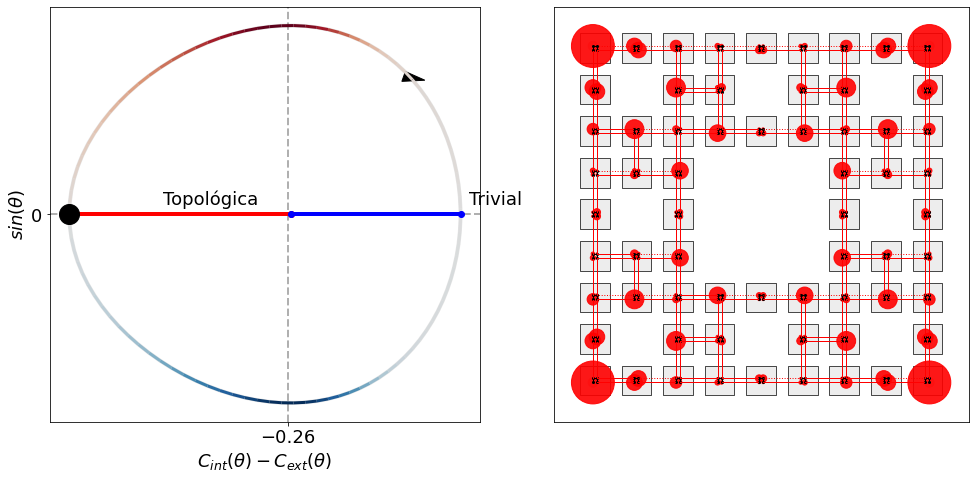

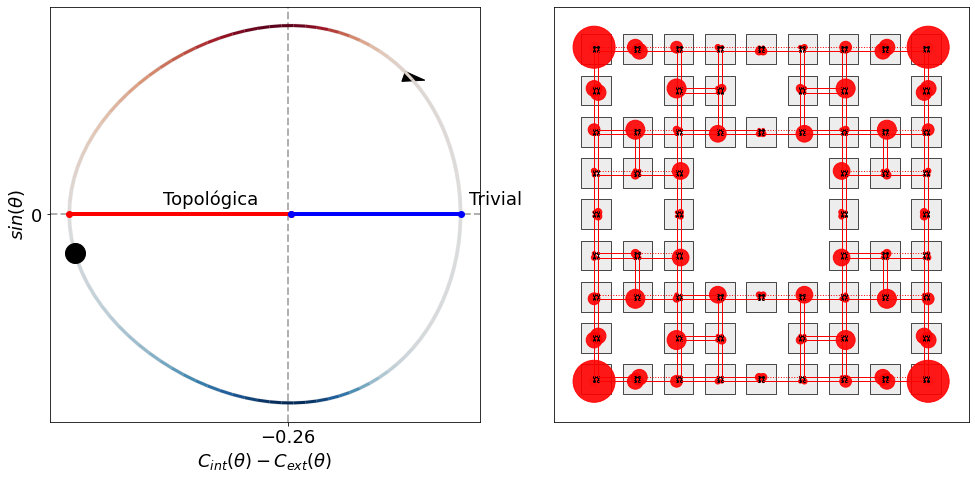

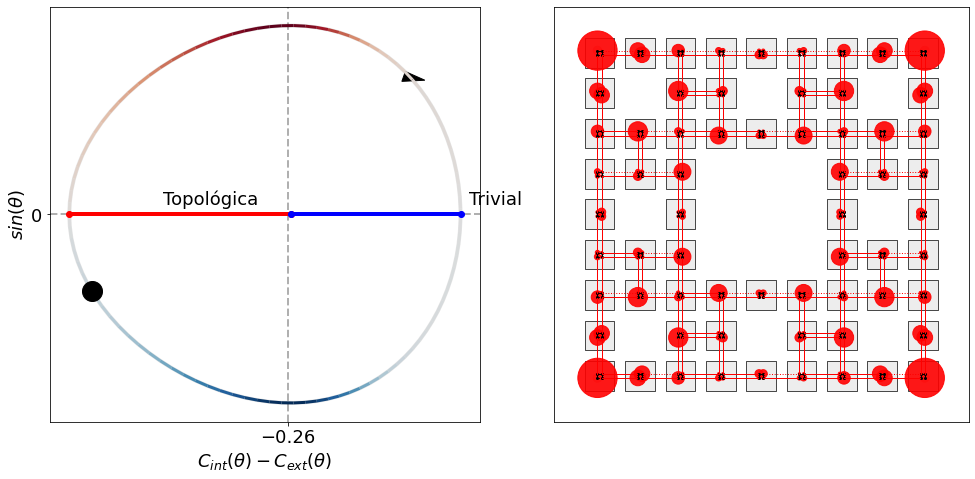

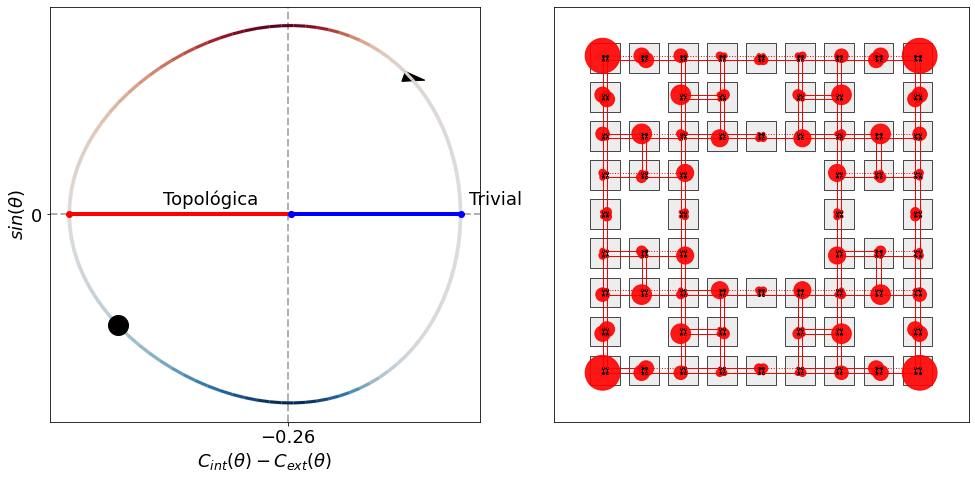

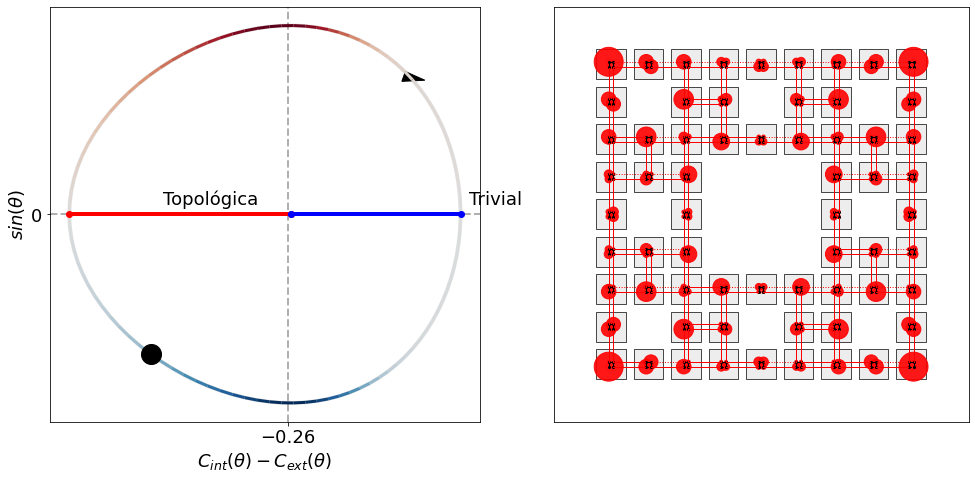

...

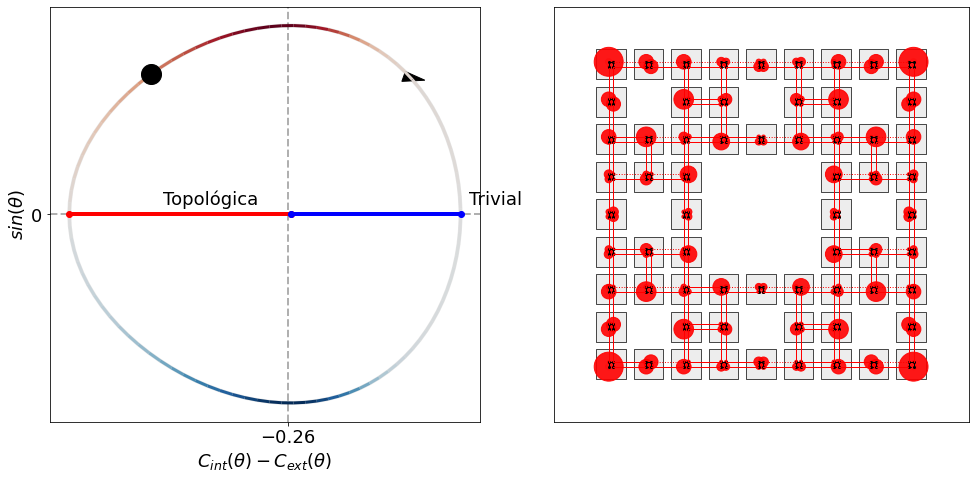

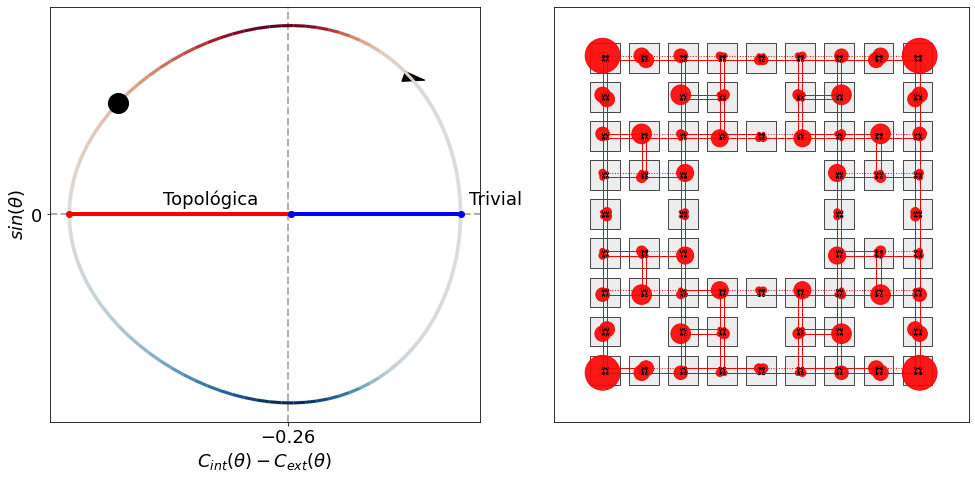

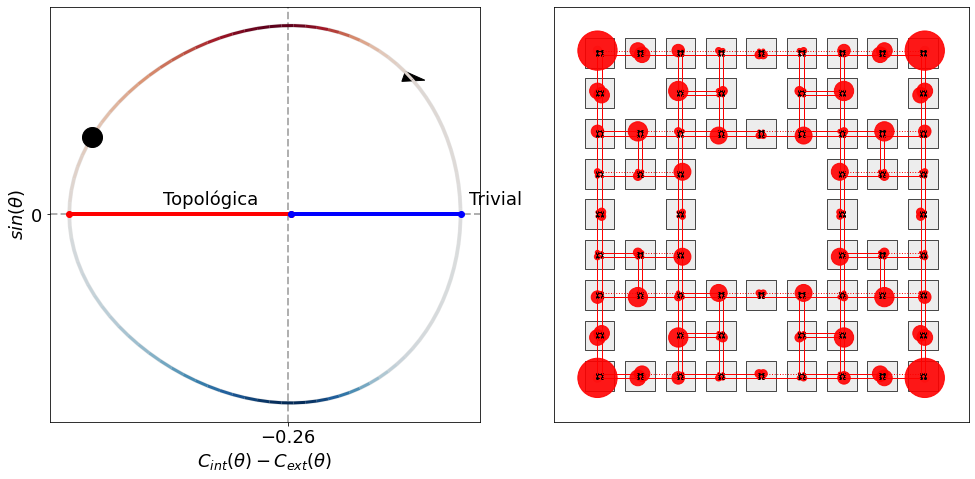

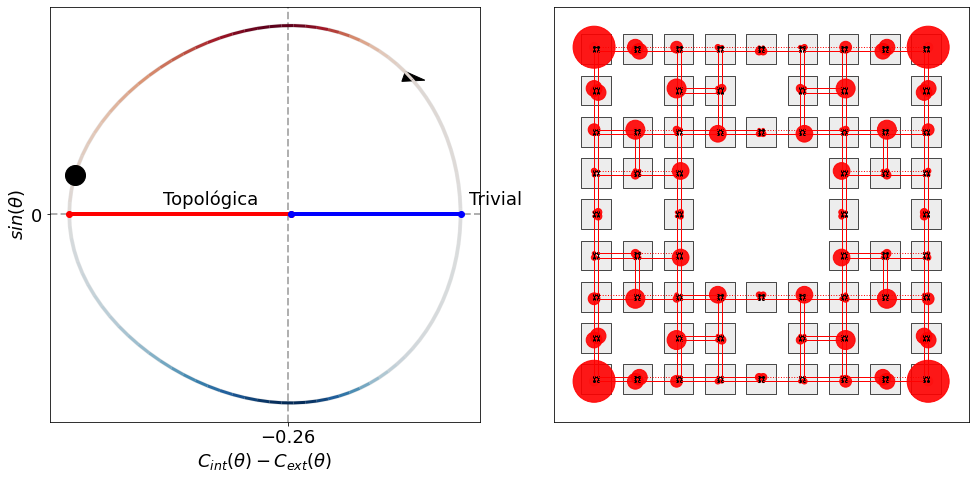

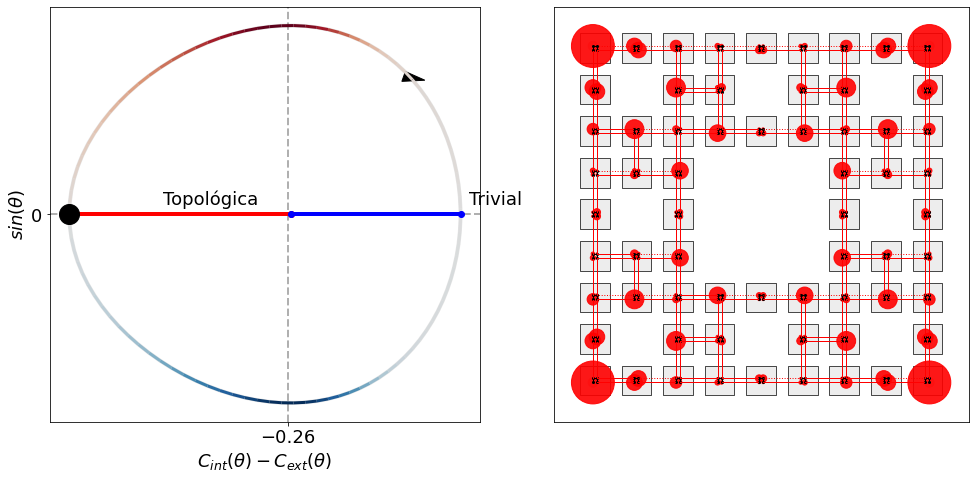

In [119]:
count=0

Jx  = loadtxt('Rx.txt',unpack=True) 
Jx  = asmatrix(Jx.T) 
val = where(Jx == amax(Jx))[0][0]

for θ in np.linspace(-pi,pi,31):
    Nx = []
    Ny = []
    cx = (np.amax(x) + np.amin(x))/2
    cy = (np.amax(y) + np.amin(y))/2
    
    for i in np.unique(f):
        find = [j for j,val in enumerate(f) if val == i]
        X = [x[i] for i in find]
        Y = [y[i] for i in find]
        xmax = np.amax(X)
        xmin = np.amin(X)
        ymax = np.amax(Y)
        ymin = np.amin(Y)
        rx = ((xmax + xmin)/2 - cy)*func_cext(θ)/2 + cx 
        ry = ((ymax + ymin)/2 - cy)*func_cext(θ)/2 + cy

        X = func_cint(θ)*(X - rx) + rx
        Y = func_cint(θ)*(Y - ry) + ry

        Nx = np.concatenate((Nx, X), axis=None)
        Ny = np.concatenate((Ny, Y), axis=None)
        
    Rx = []
    Ry = []
    for i in np.unique(f):
        find = [j for j,val in enumerate(f) if val == i]
        X = [Nx[i] for i in find]
        Y = [Ny[i] for i in find]
        xmax = np.amax(X)
        xmin = np.amin(X)
        ymax = np.amax(Y)
        ymin = np.amin(Y)
        rx = (xmax + xmin)/2
        ry = (ymax + ymin)/2
        Rx.append(rx)
        Ry.append(ry)

    
        
    fig, ax = plt.subplots(1,2, figsize=(14,7))
    ax[1].plot(Nx,Ny, marker='o', color='black', markersize=2,linestyle="")
    ax[1].scatter(Nx,Ny, color='red', alpha=0.9, s=S_array[count]*1000)
    
    ω = np.linspace(-pi,pi,100)
    ω1 = np.linspace(-pi,pi,len(array(Jx[val])[0]))
    
    
    ax[0].plot(func_cint(ω) - func_cext(ω), sin(ω), color='black', ls='-', lw=4, alpha=0.1)
    colorline(func_cint(ω1) - func_cext(ω1), sin(ω1), ax[0], array(Jx[val])[0], cmap='RdBu')

    ax[0].plot([func(-pi) , func(ts)], [sin(-pi),0], marker='o',color='red', ls='-', lw=4)
    ax[0].plot([func(0) , func(ts)], [sin(0),0], marker='o',color='blue', ls='-', lw=4)
    
    ax[0].arrow(func(pi/4), sin(pi/4), 
               func(pi/4+1e-5) - func(pi/4),sin(pi/4+1e-5) - sin(pi/4),
                  head_width=0.03, head_length=0.05, fc='black', ec='black')
    
    ax[0].text((func_cint(-pi) - func_cext(-pi))/2-0.15, sin(-pi)+0.05,'Topológica' , color='black')
    ax[0].text((func_cint(pi/2) - func_cext(pi/2))/2+0.1, sin(-pi)+0.05,'Trivial' , color='black')
    
    ax[0].plot([func_cint(θ) - func_cext(θ)], [sin(θ)], marker='o', color='black', markersize=20)


    boxes = []
    for i in range(len(Rx)):
        rect = Rectangle((Rx[i]- 0.25, Ry[i] - 0.25), 0.5,0.5)
        boxes.append(rect)
    for i in Dic.keys():
        c = 0
        for v in Dic[i]:
            if Hop[i][c] == 1:
                ax[1].plot((Nx[i],Nx[v]),(Ny[i],Ny[v]),c = 'black', lw = 1)
            elif Hop[i][c] == exp(-1J*pi)*1:
                ax[1].plot((Nx[i],Nx[v]),(Ny[i],Ny[v]),c = 'black', lw = 1, ls = ':')
            elif Hop[i][c] == 4.5:
                ax[1].plot((Nx[i],Nx[v]),(Ny[i],Ny[v]),c = 'r', lw =1)
            elif Hop[i][c] == exp(-1J*pi)*4.5:
                ax[1].plot((Nx[i],Nx[v]),(Ny[i],Ny[v]),c = 'r', lw =1, ls = ':')
            c+=1  



    pc = PatchCollection(boxes, facecolor='#e6e6e6', alpha=0.7,edgecolor='black')
    ax[1].add_collection(pc)
    
    ax[1].scatter(Nx,Ny, color='red', alpha=0.9, s=S_array[count]*20000)
    
    
    fig.tight_layout()
    ax[1].set_aspect('equal')
    #ax.set_title(r'$\lambda = 4.5, \gamma = 1$')
    ax[1].set_xticks([])
    ax[1].set_yticks([])
    ax[1].set_xlim(min(x)+5, max(x)-5)
    ax[1].set_ylim(min(y)+5, max(y)-5)
    
    
    ax[0].set_ylabel(r'$sin(\theta)$')
    ax[0].set_xlabel(r'$C_{int}(\theta) - C_{ext}(\theta)$')
    ax[0].set_xticks([round(func(ts),2)])
    ax[0].set_yticks([0.0])
    ax[0].grid(linestyle='--', lw=2)
    
    fig.tight_layout()
    #fig.savefig('hoti_pomp_{}.pdf'.format(θ))
    fig.savefig('images/video_images2/hoti_pomp_{}.png'.format(count))
    count+=1
    
    #plt.show()
    

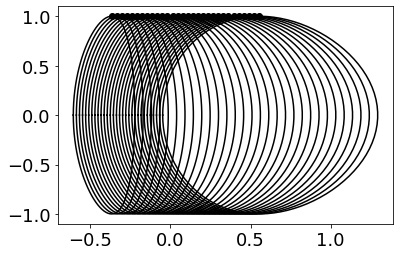

In [111]:

T = []
Mid =[]
fig, ax = plt.subplots(1)
for γv in linspace(0,2.5,30):

    def func_cext1(θ,λ):
        return  λ*exp(-κ*(L+A*cos(θ)))

    def func_cint1(θ,γ):
        return γ*exp(-κ*(L-A*cos(θ)))


    def func1(θ):
        return func_cint1(θ,γv) - func_cext1(θ,1.0) 

    def dfunc1(θ):
        h = 1e-5
        return (h*cos(θ))/(func(θ+h) - func(θ))

    def ddfunc1(θ):
        h = 1e-5
        return (dfunc(θ+h) - dfunc(θ))/h

    def trans_point1(semilla):
        x0  = semilla
        x   = 1
        cnt = 0
        while abs(x0 - x)>1e-4:
            x0 = x
            x = x - dfunc1(x)/ddfunc1(x)
            if cnt > 100:
                return s/0

        
        return round(x,2)
    
    ω = np.linspace(-pi,pi,100)
    ts = trans_point1(-0.25)
    T.append(ts)
    Mid.append((func1(-pi) + func1(0))/2)
    
    ax.plot(func1(ω), sin(ω), color='black', ls='-')
    ax.scatter(func1(ts), sin(ts), color='black')

    

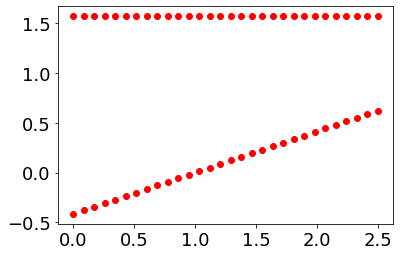

In [113]:
fig, ax = plt.subplots(1)
ax.scatter(linspace(0,2.5,30),T, color='red')
ax.scatter(linspace(0,2.5,30),Mid, color='red')

In [28]:
x,y,f = np.loadtxt(name_array,usecols=(1,2,4),skiprows=2,unpack=True)
ind = np.argsort(f)
#x,y,f = x[ind], y[ind], f[ind]

In [45]:
A   = 0.5     # μm


def func_cext(θ,A,λ):
    return  λ*exp(-(1+A*cos(θ)))

def func_cint(θ,A,γ):
    return γ*exp(-(1-A*cos(θ)))

def Hoti_Hamiltonian_transport(A, θ, γ, ϵ=epsi, natoms=natoms, M_rand=M_rand, conection=False):
    H = Hoti_Hamiltonian(func_cint(θ,A,γ), func_cext(θ,A,1), ϵ=epsi,δ=0.1*sin(θ), 
                         natoms=natoms, M_rand=M_rand, conection=True)
    return H

In [46]:
dic_rx = dict.fromkeys(range(len(x)))
dic_ry = dict.fromkeys(range(len(y)))
for i in unique(f):
    rx = reshape(argwhere(f == i),(len(argwhere(f == i))))
    px = mean(x[rx])
    py = mean(y[rx])
    
    for j in rx:
        
        dic_rx[j] = px-0.5
        dic_ry[j] = py-0.5
        

Lx = array([sum(dic_rx[i]) for i in dic_rx.keys()])
Lxmax = max(Lx)
Lx = Lx/max(Lx)
 
    
Ly = array([sum(dic_ry[i]) for i in dic_ry.keys()])
Lymax = max(Ly)
Ly = Ly/max(Ly)

In [47]:
dic_rx

{0: 0.0,
 1: 0.0,
 2: 0.0,
 3: 0.0,
 4: 0.0,
 5: 0.0,
 6: 0.0,
 7: 0.0,
 8: 0.0,
 9: 0.0,
 10: 0.0,
 11: 0.0,
 12: 2.0,
 13: 2.0,
 14: 2.0,
 15: 2.0,
 16: 2.0,
 17: 2.0,
 18: 2.0,
 19: 2.0,
 20: 4.0,
 21: 4.0,
 22: 4.0,
 23: 4.0,
 24: 4.0,
 25: 4.0,
 26: 4.0,
 27: 4.0,
 28: 4.0,
 29: 4.0,
 30: 4.0,
 31: 4.0,
 32: 0.0,
 33: 0.0,
 34: 0.0,
 35: 0.0,
 36: 0.0,
 37: 0.0,
 38: 0.0,
 39: 0.0,
 40: 0.0,
 41: 0.0,
 42: 0.0,
 43: 0.0,
 44: 2.0,
 45: 2.0,
 46: 2.0,
 47: 2.0,
 48: 2.0,
 49: 2.0,
 50: 2.0,
 51: 2.0,
 52: 4.0,
 53: 4.0,
 54: 4.0,
 55: 4.0,
 56: 4.0,
 57: 4.0,
 58: 4.0,
 59: 4.0,
 60: 4.0,
 61: 4.0,
 62: 4.0,
 63: 4.0,
 64: 0.0,
 65: 0.0,
 66: 0.0,
 67: 0.0,
 68: 0.0,
 69: 0.0,
 70: 0.0,
 71: 0.0,
 72: 0.0,
 73: 0.0,
 74: 0.0,
 75: 0.0,
 76: 2.0,
 77: 2.0,
 78: 2.0,
 79: 2.0,
 80: 2.0,
 81: 2.0,
 82: 2.0,
 83: 2.0,
 84: 4.0,
 85: 4.0,
 86: 4.0,
 87: 4.0,
 88: 4.0,
 89: 4.0,
 90: 4.0,
 91: 4.0,
 92: 4.0,
 93: 4.0,
 94: 4.0,
 95: 4.0,
 96: 6.0,
 97: 6.0,
 98: 6.0,
 99: 6.0,
 100: 6.0,

In [48]:
POSx=matrix(diag(exp(2*pi*1j*Lx)))
POSy=matrix(diag(exp(2*pi*1j*Ly)))

Lwanflow=[]
Hwanflow=[]
Lwane=[]
Hwane=[]
for θ in linspace(-pi,pi,51):
    H=matrix(Hoti_Hamiltonian_transport(0.5,θ,nval,conection=True))
    sys=eigh(H)

    Lval=sys[0][sys[0]<0]
    Lvec=matrix(sys[1][:,sys[0]<0])
    LP=Lvec*Lvec.H
    LW=LP*POSy*LP
    LWval,LWvec=eig(LW)
    LWvec=LWvec[:,abs(LWval)>1e-10]
    LWe=real(diag(LWvec.H*H*LWvec))
        
    Hval=sys[0][sys[0]>0]
    Hvec=matrix(sys[1][:,sys[0]>0])
    HP=Hvec*Hvec.H
    HW=HP*POSy*HP
    HWval,HWvec=eig(HW)
    HWvec=HWvec[:,abs(HWval)>1e-10]
    HWe=real(diag(HWvec.H*H*HWvec))
    
    Hwanflow=append(Hwanflow,Lxmax/(2*pi)*sort(angle(HWval[abs(HWval)>1e-10])))
    Lwanflow=append(Lwanflow,Lxmax/(2*pi)*sort(angle(LWval[abs(LWval)>1e-10])))
    

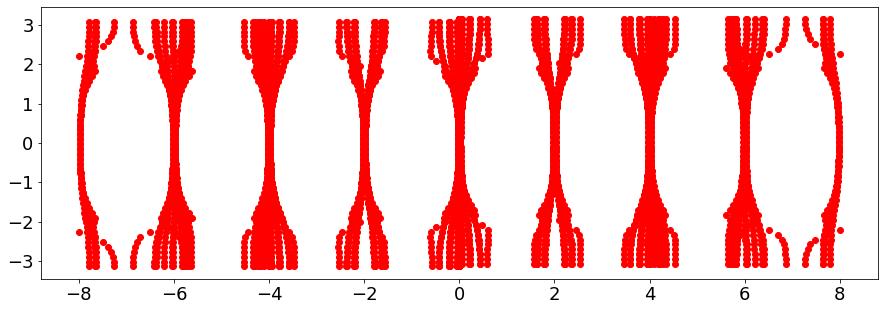

In [49]:
fig, ax = subplots(figsize=(15,5))
Ls = int(natoms/4)
for i in range(Ls):
    xa= real(Lwanflow[i::Ls])
    xa1= real(Hwanflow[i::Ls])
    #ax.plot(xa,linspace(-pi,pi,len(xa)),'ko',c='b')
    #ax.set_xlim(0,15)
    ax.plot(xa1,linspace(-pi,pi,len(xa1)),'ko',c='r')

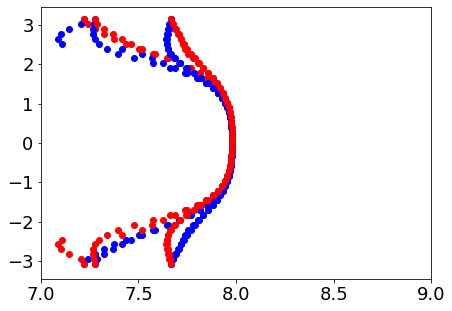

In [41]:
fig, ax = subplots(figsize=(7,5))
Ls = int(natoms/4)
for i in range(Ls):
    xa= real(Lwanflow[i::Ls])
    xa1= real(Hwanflow[i::Ls])
    ax.plot(xa,linspace(-pi,pi,len(xa)),'ko',c='b')
    ax.set_xlim(7,9)
    ax.plot(xa1,linspace(-pi,pi,len(xa1)),'ko',c='r')

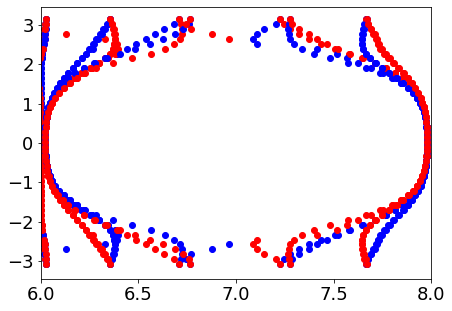

In [42]:
fig, ax = subplots(figsize=(7,5))
Ls = int(natoms/4)
for i in range(Ls):
    xa= real(Lwanflow[i::Ls])
    xa1= real(Hwanflow[i::Ls])
    ax.plot(xa,linspace(-pi,pi,len(xa)),'ko',c='b')
    ax.set_xlim(6,8)
    ax.plot(xa1,linspace(-pi,pi,len(xa1)),'ko',c='r')